# Comparing parameter initialisation schemes for a toy neural network

I had an idea for initialising the parameters of a neural network with ReLU activations so that the knots in the initial function output are spread evenly across the domain of the training data.  It seems to avoid local optima better than the default random intialisation scheme.  In this code I'm referring to my scheme as grid initialisation.  It seems to end up with a loss that's between 3x and 20x better on these toy problems.

In [1]:
# Import packages
import numpy as np
import torch
from Code.gdtnn import *

In [2]:
# Make data
n_data = 101
x = torch.linspace(-1, 1, n_data).reshape(n_data, 1)

# Target functions, from easy to hard
y1 = torch.maximum(2 * x, torch.zeros_like(x))
y2 = (x - 0.2)**3
y3 = np.sin(2 * np.pi * (x + 0.2))
y = y1 + y2 + y3

# Get cpu or gpu device for training
device = "cuda" if torch.cuda.is_available() else "cpu"
print("Using {} device".format(device))
x, y = x.to(device), y.to(device)

# Make neural net with set number of neurons in hidden layer
n_hidden = 10

Using cuda device


target 0


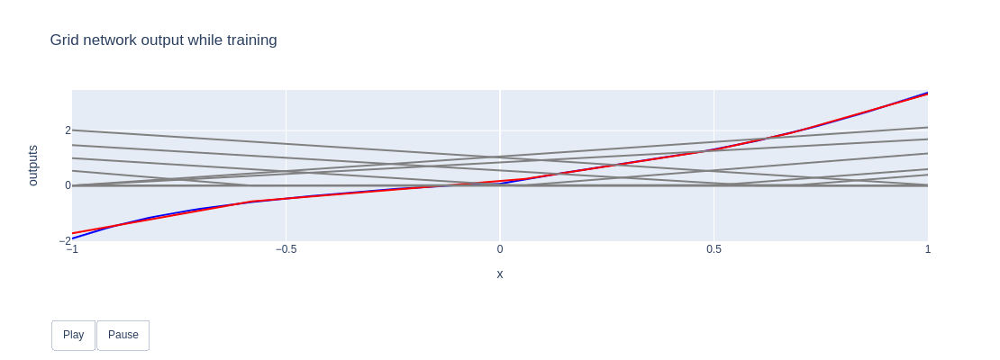

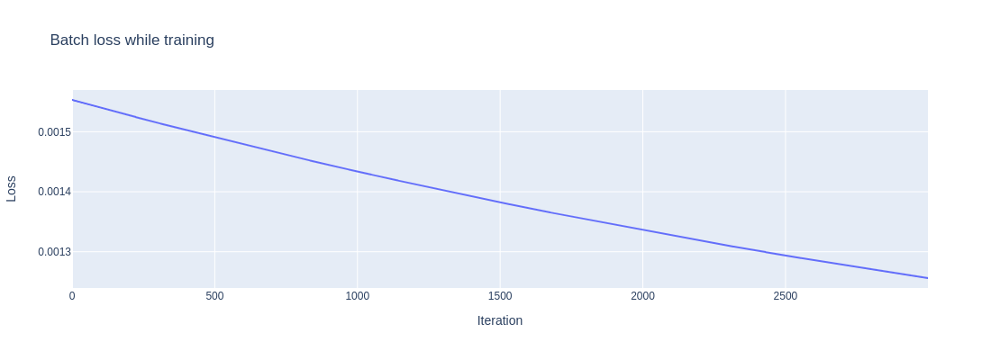

grid loss 0.0012560209725052118
random model 0
random model 1
random model 2
random model 3
random model 4
random model 5
random model 6
random model 7
random model 8
random model 9
random losses tensor([0.0130, 0.0012, 0.0046, 0.0024, 0.0126, 0.0017, 0.0011, 0.0119, 0.0012,
        0.0118], grad_fn=<SliceBackward>)
mean random loss 0.0061487676575779915
target 1


grid loss 0.009469660930335522
random model 0
random model 1
random model 2
random model 3
random model 4
random model 5
random model 6
random model 7
random model 8
random model 9
random losses tensor([0.0112, 0.0094, 0.3748, 0.3748, 0.3831, 0.3870, 0.0101, 0.3819, 0.0928,
        0.3747], grad_fn=<SliceBackward>)
mean random loss 0.23998741805553436
target 2


grid loss 0.01982703059911728
random model 0
random model 1
random model 2
random model 3
random model 4
random model 5
random model 6
random model 7
random model 8
random model 9
random losses tensor([0.3453, 0.5685, 0.0906, 0.2998, 0.3424, 0.5694, 0.2998, 0.2998, 0.3015,
        0.5651], grad_fn=<SliceBackward>)
mean random loss 0.36820200085639954
target 3


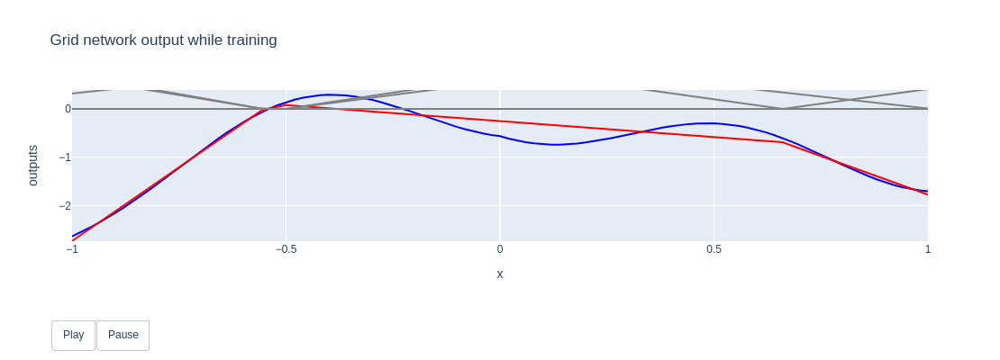

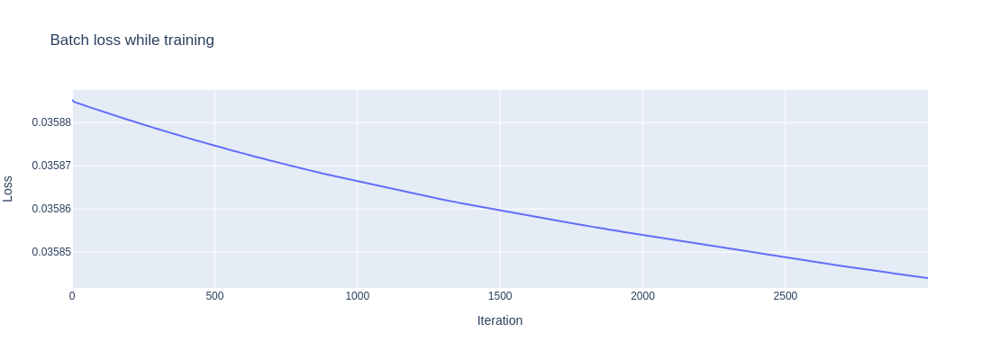

grid loss 0.035843975841999054
random model 0
random model 1
random model 2
random model 3
random model 4
random model 5
random model 6
random model 7
random model 8
random model 9
random losses tensor([0.0359, 0.0413, 0.0585, 0.0583, 0.0366, 0.0021, 0.0359, 0.0584, 0.0359,
        0.0584], grad_fn=<SliceBackward>)
mean random loss 0.04212502762675285
target 4


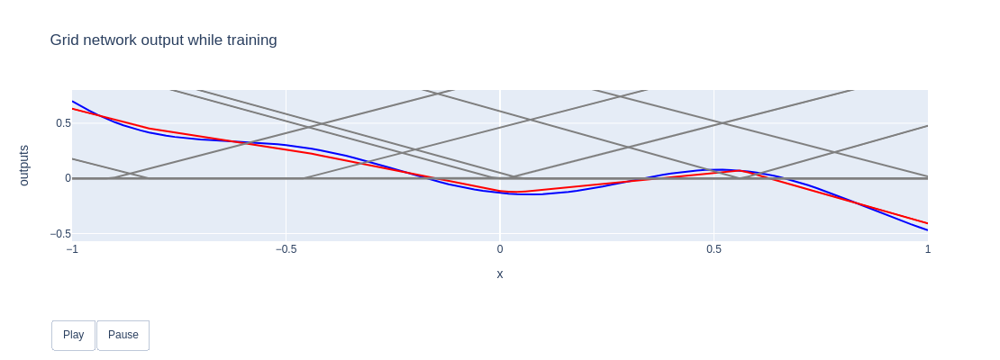

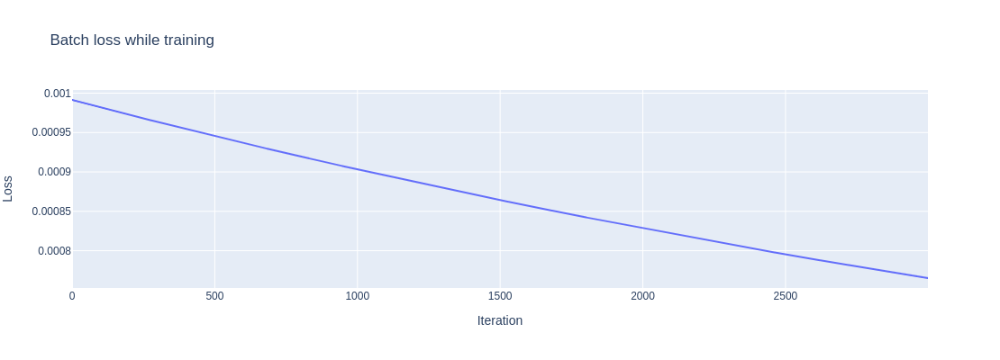

grid loss 0.0007652376079931855
random model 0
random model 1
random model 2
random model 3
random model 4
random model 5
random model 6
random model 7
random model 8
random model 9
random losses tensor([0.0013, 0.0012, 0.0016, 0.0013, 0.0101, 0.0035, 0.0011, 0.0017, 0.0013,
        0.0102], grad_fn=<SliceBackward>)
mean random loss 0.0033335972111672163
target 5


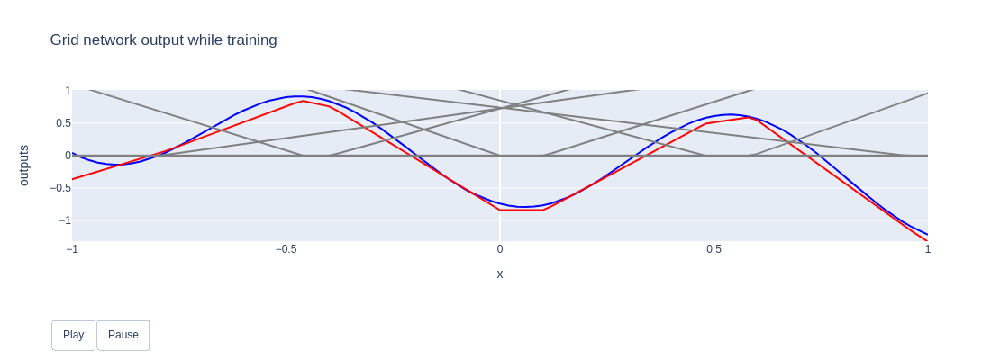

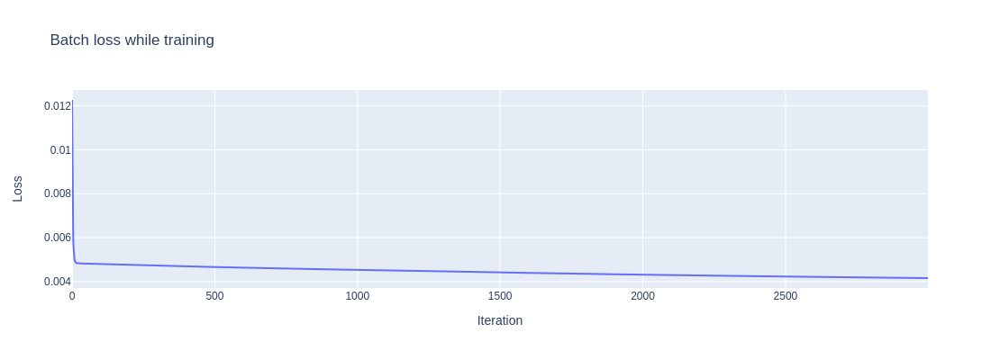

grid loss 0.0041610305197536945
random model 0
random model 1
random model 2
random model 3
random model 4
random model 5
random model 6
random model 7
random model 8
random model 9
random losses tensor([0.1445, 0.1765, 0.0052, 0.0053, 0.2101, 0.0836, 0.0470, 0.0065, 0.0389,
        0.0130], grad_fn=<SliceBackward>)
mean random loss 0.0730670839548111
target 6


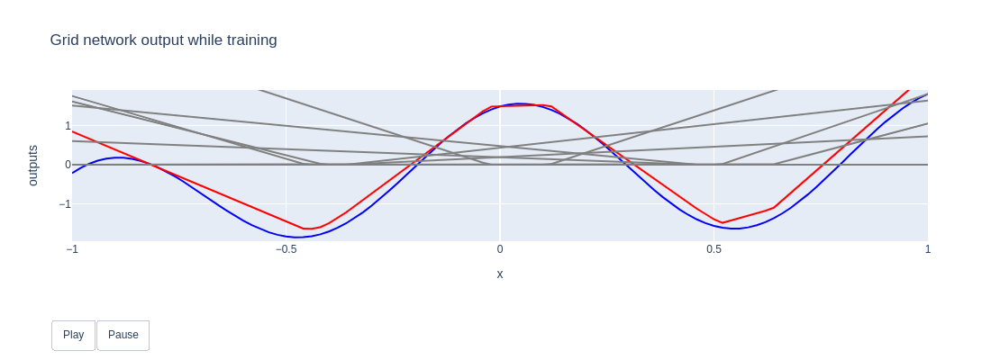

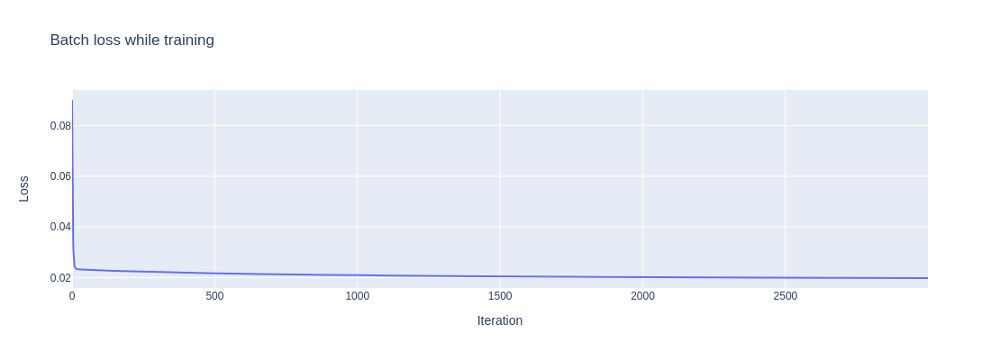

grid loss 0.019784145057201385
random model 0
random model 1
random model 2
random model 3
random model 4
random model 5
random model 6
random model 7
random model 8
random model 9
random losses tensor([0.1934, 0.0258, 0.9440, 0.1782, 0.7156, 0.5612, 0.6128, 0.2559, 0.0195,
        0.0206], grad_fn=<SliceBackward>)
mean random loss 0.35269513726234436
target 7


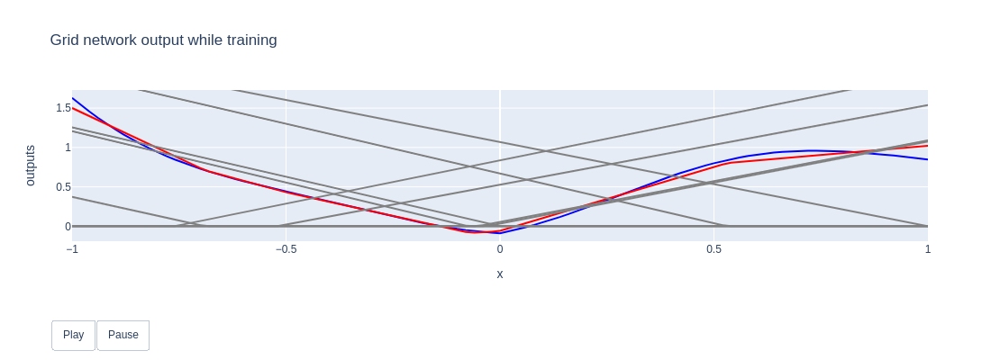

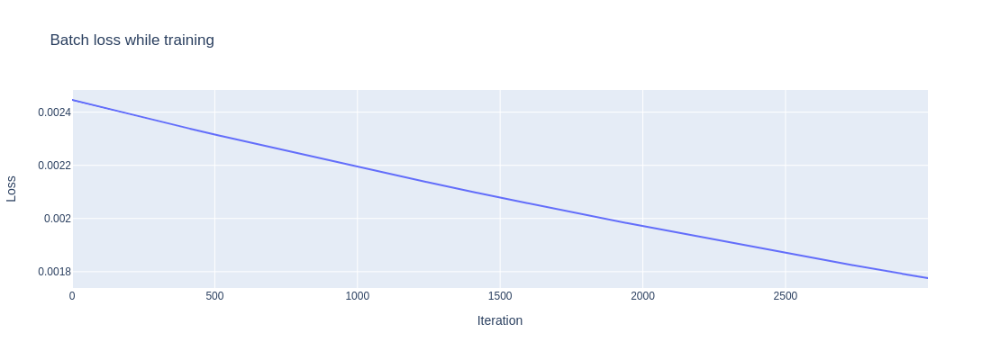

grid loss 0.0017758520552888513
random model 0
random model 1
random model 2
random model 3
random model 4
random model 5
random model 6
random model 7
random model 8
random model 9
random losses tensor([0.0013, 0.0016, 0.0042, 0.0112, 0.0024, 0.0013, 0.0012, 0.0012, 0.0133,
        0.0118], grad_fn=<SliceBackward>)
mean random loss 0.0049543981440365314
target 8


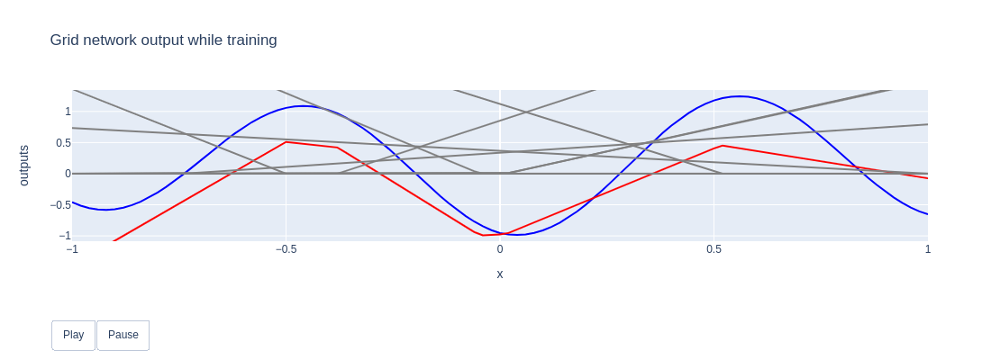

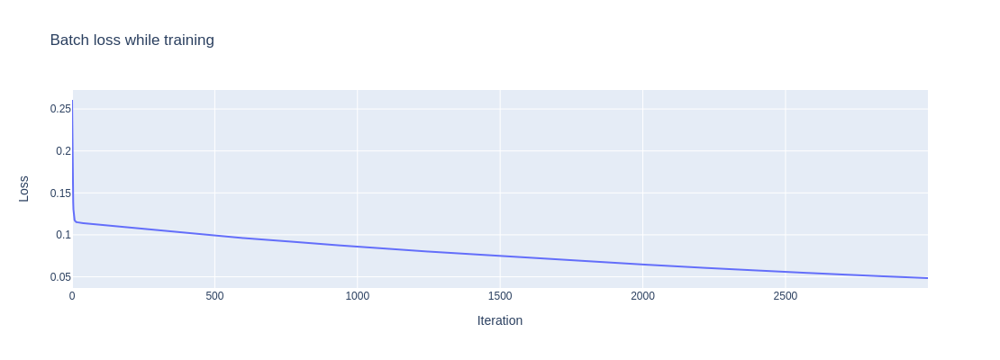

grid loss 0.04843384027481079
random model 0
random model 1
random model 2
random model 3
random model 4
random model 5
random model 6
random model 7
random model 8
random model 9
random losses tensor([0.0799, 0.0663, 0.0084, 0.3499, 0.4409, 0.0728, 0.4042, 0.2734, 0.0856,
        0.4007], grad_fn=<SliceBackward>)
mean random loss 0.21821875870227814
target 9


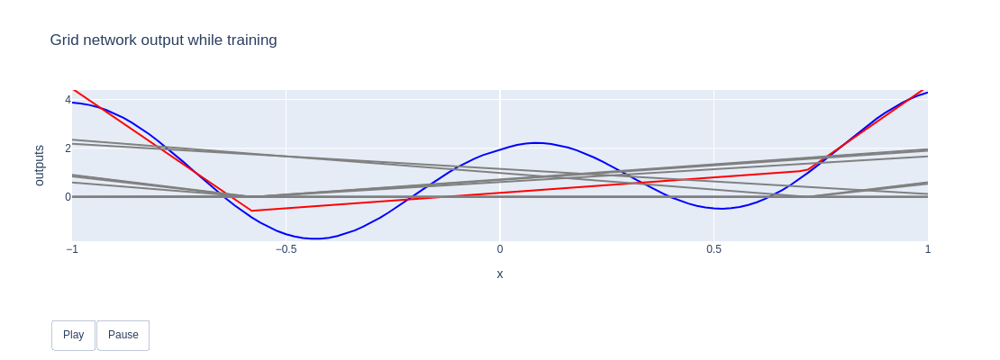

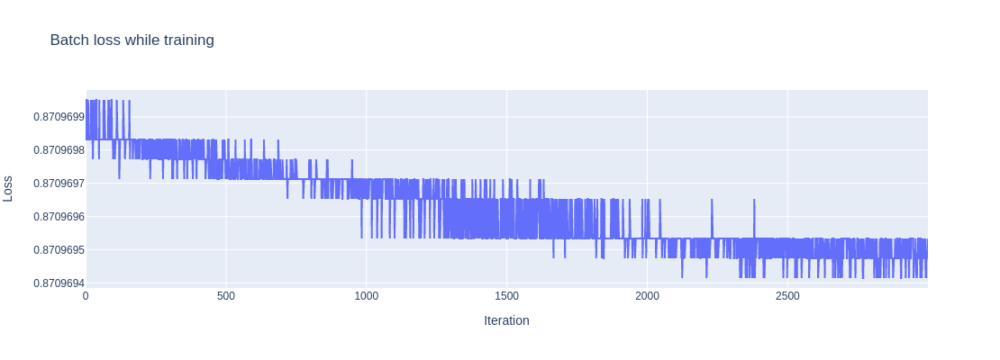

grid loss 0.8709694743156433
random model 0
random model 1
random model 2
random model 3
random model 4
random model 5
random model 6
random model 7
random model 8
random model 9
random losses tensor([0.8699, 0.9372, 0.8710, 1.0962, 0.8687, 0.8710, 0.8710, 0.8710, 0.8710,
        1.0962], grad_fn=<SliceBackward>)
mean random loss 0.9222967028617859
grid losses tensor([1.2560e-03, 9.4697e-03, 1.9827e-02, 3.5844e-02, 7.6524e-04, 4.1610e-03,
        1.9784e-02, 1.7759e-03, 4.8434e-02, 8.7097e-01], grad_fn=<CopySlices>)
random average losses tensor([0.1696, 0.1829, 0.2363, 0.2377, 0.3022, 0.2554, 0.2284, 0.2162, 0.1461,
        0.2562], grad_fn=<MeanBackward1>)
average grid loss 0.10122863203287125
average random loss 0.223102867603302


In [3]:
# Train grid and non grid-initialised models on multiple random functions and compare results
# Number of target functions
n_targets = 10

# Number of randomly initialised (non-grid) models to fit for each target function
n_models = 10

# Vector for loss of grid model on each target function
grid_loss_vec = torch.zeros(n_targets)

# Loss for each non-grid model for each target function
loss_mat = torch.zeros((n_targets, n_models))

# Loop over target functions
for t in range(n_targets):
    print(f"target {t}")
    t_weights = torch.randn((1, 3))
    y = (t_weights @ torch.stack((y1, y2, y3), dim=1))[:, :, 0].to(device)
    model = ToyNN(n_hidden, grid=True).to(device)
    data_list, loss_vec = grad_desc(x, y, model, n_data, n_hidden, lr=1e-1, max_it=int(2e3), plot_every=2e2)
    data_list, loss_vec = grad_desc(x, y, model, n_data, n_hidden, lr=1e-2, max_it=int(3e3), plot_every=2e2)
    plot_animation(y.cpu(), data_list, showlegend=False, title='Grid network output while training')
    plot_loss(loss_vec)
    grid_loss_vec[t] = loss_vec[-1]
    print(f"grid loss {grid_loss_vec[t]}")
    
#     Loop over non-grid models
    for m in range(n_models):
        print(f"random model {m}")
        model = ToyNN(n_hidden, grid=False).to(device)
        data_list, loss_vec = grad_desc(x, y, model, n_data, n_hidden, lr=1e-1, max_it=int(2e3), plot_every=2e3)
        data_list, loss_vec = grad_desc(x, y, model, n_data, n_hidden, lr=1e-2, max_it=int(3e3), plot_every=3e3)
        loss_mat[t, m] = loss_vec[-1]
    print(f"random losses {loss_mat[t, :]}")
    print(f"mean random loss {torch.mean(loss_mat[t, :])}")
    
# Print results
print(f"grid losses {grid_loss_vec}")
print(f"random average losses {torch.mean(loss_mat, dim=1)}")
print(f"average grid loss {torch.mean(grid_loss_vec)}")
print(f"average random loss {torch.mean(loss_mat)}")

In [15]:
# Print results
print(f"Grid losses")
print(grid_loss_vec)
print(f"Average random losses")
print(torch.mean(loss_mat, dim=1))
print(f"Ratios of losses on targets")
print(grid_loss_vec / torch.mean(loss_mat, dim=1))
print("")
print(f"Mean ratio on targets {torch.mean(grid_loss_vec / torch.mean(loss_mat, dim=1))}")

Grid losses
tensor([1.2560e-03, 9.4697e-03, 1.9827e-02, 3.5844e-02, 7.6524e-04, 4.1610e-03,
        1.9784e-02, 1.7759e-03, 4.8434e-02, 8.7097e-01], grad_fn=<CopySlices>)
Average random losses
tensor([0.0061, 0.2400, 0.3682, 0.0421, 0.0033, 0.0731, 0.3527, 0.0050, 0.2182,
        0.9223], grad_fn=<MeanBackward1>)
Ratios of losses on targets
tensor([0.2043, 0.0395, 0.0538, 0.8509, 0.2296, 0.0569, 0.0561, 0.3584, 0.2220,
        0.9443], grad_fn=<DivBackward0>)

Mean ratio on targets 0.30158084630966187
